In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
sc.set_figure_params(figsize=(8,8), fontsize=15, )
import random
import numpy as np
from numpy import linalg as LA
from FACS_Sampling.preprocessing.utils import create_adata, read_tcell
from FACS_Sampling.methods.methods import sample_random, bin_sample, proportional_sampling, corr_sampling
from FACS_Sampling.plotting.plotting import plot_umap

import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
adata = read_tcell("../../FACS_Sampling/datasets/Final_Focal_Tcell_Selected_Patients_All_Cells.csv")

/Users/ekarimi/PycharmProjects/FACS_Sampling/FACS_Sampling/preprocessing/utils.py:35: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = sc.AnnData(X, obs=obs, var=var)
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [3]:
rare_cell_types = ['CD8+ tissue-res mem', 'CD8+ CD39+ PD1+', 'CD8+ CD38- gd',
                  'CD45RA- IL7R+ gd', 'CD8+ mem stem', 'CD8- CD38- gd',
                  'CD4+ CD103+', 'CD8- CD38+ gd', 'CD45RA+ IL7R+ gd',
                  'CD8+ CD38+ gd']
# important_indx = adata[samples].obs[adata[samples].obs['Refined_clustering'].isin(rare_cell_types)].index.to_numpy().astype(int)

In [4]:
corr_s = corr_sampling(adata)

In [5]:
corr_s.shape

(4172,)

In [6]:
bin_s, tot = bin_sample(adata, n_bins=10, s_size=21)



In [7]:
bin_s.shape

(4256,)

In [8]:
prop_s, tot = proportional_sampling(adata,  total_size=186, n_bins=10)



In [9]:
prop_s.shape

(4184,)

In [10]:
s = max(corr_s.shape, bin_s.shape, prop_s.shape)[0]

In [11]:

random_s = sample_random(adata, s_size=s, seed=654342)
ref_s = sample_random(adata, s_size=20000, seed= 2352352)

In [12]:
# count, unique = np.unique(tot, return_counts=True)
# dict(zip(count, unique))

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


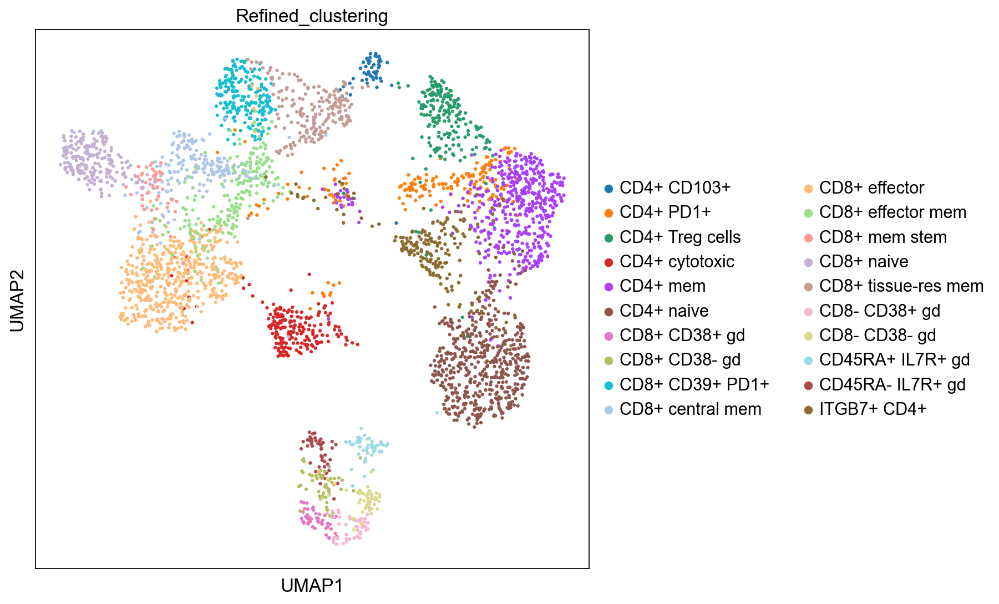

In [13]:
## stratified subsampeled

cluster_key = 'Refined_clustering'
target_cells = 30

adatas = [adata[adata.obs[cluster_key].isin([clust])] for clust in adata.obs[cluster_key].cat.categories]

for dat in adatas:
    if dat.n_obs > 100000:
         sc.pp.subsample(dat, n_obs=500)
    elif dat.n_obs > 10000:
         sc.pp.subsample(dat, n_obs=200)
    else:
         sc.pp.subsample(dat, n_obs=50)
            
adata_downsampled = adatas[0].concatenate(*adatas[1:])

sc.pp.neighbors(adata_downsampled, n_neighbors = 30)
sc.tl.umap(adata_downsampled)
sc.pl.umap(adata_downsampled, color='Refined_clustering')

In [14]:
down_cat = adata_downsampled.obs['Refined_clustering'].cat.categories
down_colors = adata_downsampled.uns['Refined_clustering_colors']
dictionary = dict(zip(down_cat, down_colors))

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


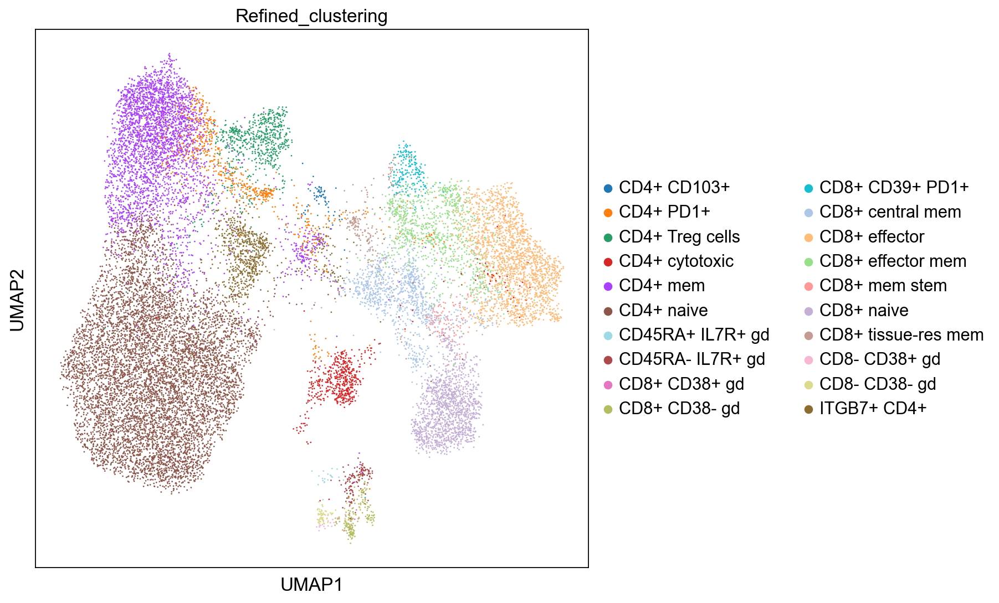

In [15]:
ref_adata = adata[ref_s]
plot_umap(ref_adata, dictionary)

### Take the artificial reference 

In [28]:
corr_s = corr_sampling(ref_adata, sample_per_matrix= 15, rng= 101, seed = 125325)
corr_s.shape

(2972,)

In [29]:
s_partially_s, _ = bin_sample(ref_adata, n_bins=14, s_size=20)
print(s_partially_s.size)
s_random_s = sample_random(ref_adata, s_size=s_partially_s.size)
s_prop_s, tot = proportional_sampling(ref_adata, n_bins=16, total_size=189, power= 0.01, seed= 12345)



2971


In [30]:
s_prop_s, tot = proportional_sampling(ref_adata, n_bins=16, total_size=189, power= 0.01, seed= 12345)
print(s_prop_s.size)

2968


In [35]:
def plot_umap(adata, dictionary, celltype_key ='Refined_clustering'):
    sc.pp.neighbors(adata, n_neighbors = 30)
    sc.tl.umap(adata)
    ref_cat = adata.obs[celltype_key].cat.categories
    dic = [dictionary[key] for key in ref_cat]
    adata.uns[celltype_key + '_colors'] = dic
    # sc.pl.umap(adata, color=celltype_key)

### Plots

In [53]:
sc.set_figure_params(dpi=300, color_map = 'viridis_r', figsize=(8,8), fontsize=15,)
sc.settings.verbosity = 1
sc.logging.print_header()
# sc.set_figure_params(figsize=(8,8), fontsize=15, )



scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.10.0 pandas==1.5.2 scikit-learn==1.2.0 statsmodels==0.13.5 python-igraph==0.9.11 pynndescent==0.5.8


In [69]:
small_random_adata = ref_adata[s_random_s]
plot_umap(small_random_adata, dictionary)
sc.tl.leiden(small_random_adata, resolution= 5)

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


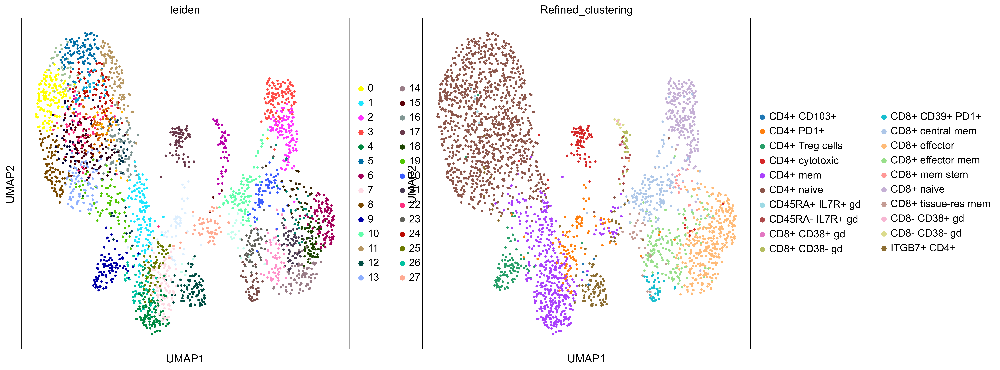

In [73]:
sc.pl.umap(small_random_adata, color=['leiden', 'Refined_clustering'], save= "uniform")

In [71]:
small_partially_adata = ref_adata[s_partially_s]
plot_umap(small_partially_adata, dictionary)
sc.tl.leiden(small_partially_adata, resolution= 5)

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


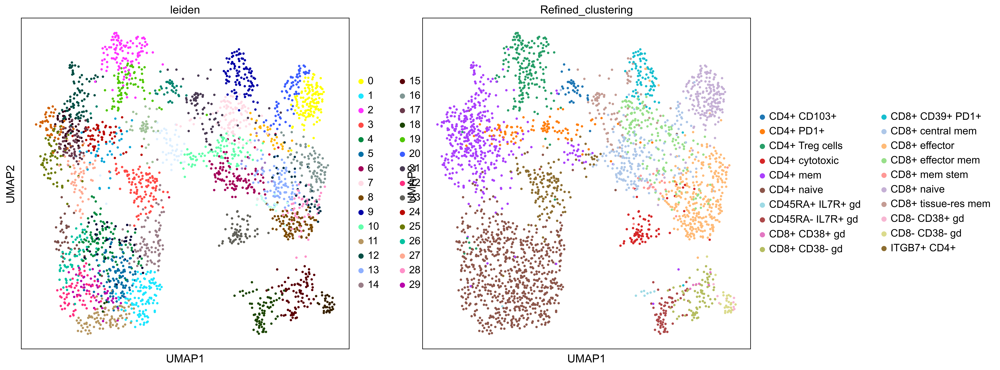

In [74]:
sc.pl.umap(small_partially_adata, color=['leiden', 'Refined_clustering'], save='FSBS')

In [75]:
small_prop_adata = ref_adata[s_prop_s]
plot_umap(small_prop_adata, dictionary)
sc.tl.leiden(small_prop_adata, resolution= 5)

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


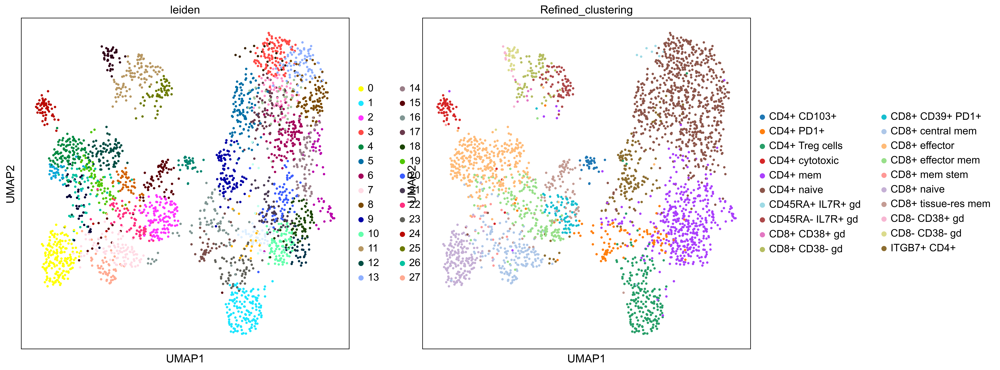

In [76]:
sc.pl.umap(small_prop_adata, color=['leiden', 'Refined_clustering'], save="prop")

In [77]:
small_corr_adata = ref_adata[corr_s]
plot_umap(small_corr_adata, dictionary)
sc.tl.leiden(small_corr_adata, resolution= 5)

/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/ekarimi/opt/anaconda3/envs/FACS_Sampling/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


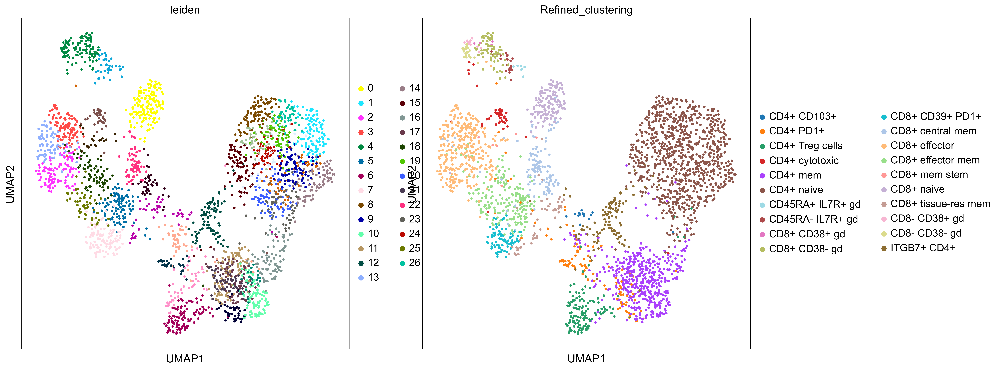

In [79]:
sc.pl.umap(small_corr_adata, color=['leiden', 'Refined_clustering'], save="CORR")

In [28]:
cell_type_order = ref_adata.obs['Refined_clustering'].value_counts().keys().values

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 [Text(0, 0, 'CD4+ naive'),
  Text(1, 0, 'CD4+ mem'),
  Text(2, 0, 'CD8+ effector'),
  Text(3, 0, 'CD8+ naive'),
  Text(4, 0, 'CD8+ central mem'),
  Text(5, 0, 'CD8+ effector mem'),
  Text(6, 0, 'ITGB7+ CD4+'),
  Text(7, 0, 'CD4+ PD1+'),
  Text(8, 0, 'CD4+ Treg cells'),
  Text(9, 0, 'CD4+ cytotoxic'),
  Text(10, 0, 'CD8+ CD39+ PD1+'),
  Text(11, 0, 'CD8+ tissue-res mem'),
  Text(12, 0, 'CD8+ CD38- gd'),
  Text(13, 0, 'CD45RA- IL7R+ gd'),
  Text(14, 0, 'CD8+ mem stem'),
  Text(15, 0, 'CD8- CD38- gd'),
  Text(16, 0, 'CD4+ CD103+'),
  Text(17, 0, 'CD8- CD38+ gd'),
  Text(18, 0, 'CD45RA+ IL7R+ gd'),
  Text(19, 0, 'CD8+ CD38+ gd')])

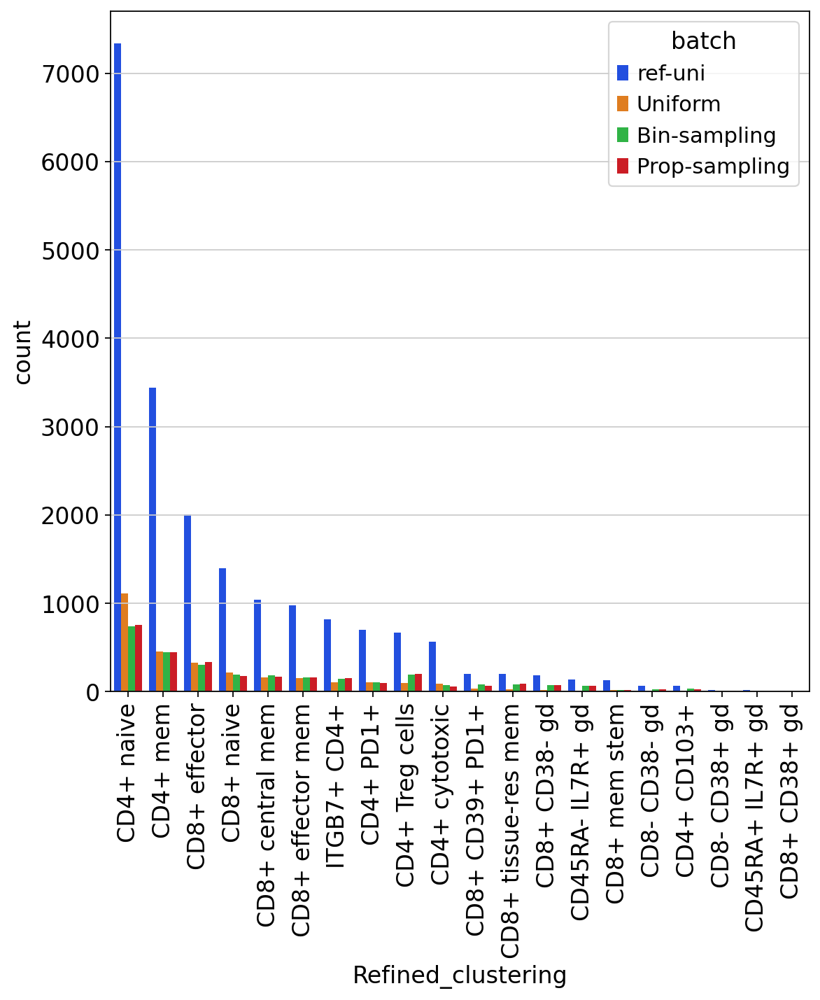

In [29]:
import matplotlib.pyplot as plt
import seaborn as sns

ref_adata.obs['batch'] = 'ref-uni'
small_random_adata.obs['batch'] = 'Uniform'
small_partially_adata.obs['batch'] = 'Bin-sampling'
small_prop_adata.obs['batch'] = 'Prop-sampling'
df_mixed = pd.concat([ref_adata.obs, small_random_adata.obs, small_partially_adata.obs, small_prop_adata.obs])
g2 = sns.countplot(data=df_mixed, x="Refined_clustering", hue="batch", palette="bright", order=cell_type_order)
plt.xticks(rotation=90)

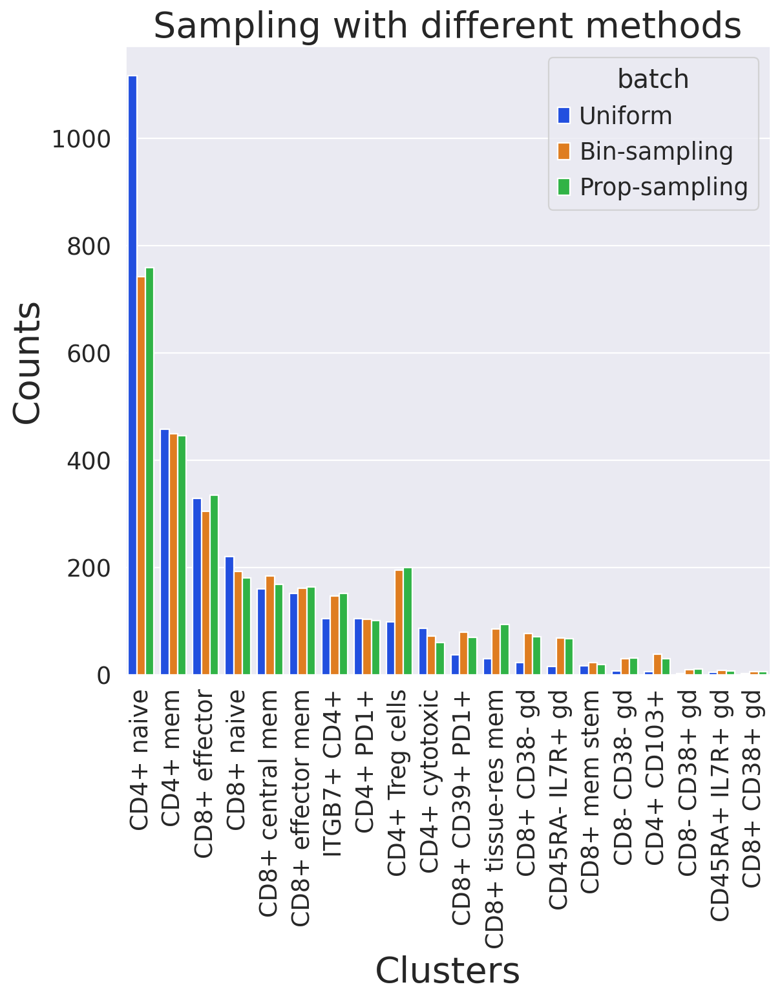

In [133]:
df_mixed = pd.concat([small_random_adata.obs, small_partially_adata.obs, small_prop_adata.obs])
g2 = sns.countplot(data=df_mixed, x="Refined_clustering", hue="batch", palette="bright", order=cell_type_order)
plt.xticks(rotation=90)
plt.ylabel("Counts", size = 25)
plt.xlabel("Clusters", size = 25)
plt.title("Sampling with different methods", size= 25)
plt.savefig("all_methods.png", dpi=200, bbox_inches='tight', pad_inches = 0.5)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 [Text(0, 0, 'CD4+ naive'),
  Text(1, 0, 'CD4+ mem'),
  Text(2, 0, 'CD8+ effector'),
  Text(3, 0, 'CD8+ naive'),
  Text(4, 0, 'CD8+ central mem'),
  Text(5, 0, 'CD8+ effector mem'),
  Text(6, 0, 'ITGB7+ CD4+'),
  Text(7, 0, 'CD4+ PD1+'),
  Text(8, 0, 'CD4+ Treg cells'),
  Text(9, 0, 'CD4+ cytotoxic'),
  Text(10, 0, 'CD8+ CD39+ PD1+'),
  Text(11, 0, 'CD8+ tissue-res mem'),
  Text(12, 0, 'CD8+ CD38- gd'),
  Text(13, 0, 'CD45RA- IL7R+ gd'),
  Text(14, 0, 'CD8+ mem stem'),
  Text(15, 0, 'CD8- CD38- gd'),
  Text(16, 0, 'CD4+ CD103+'),
  Text(17, 0, 'CD8- CD38+ gd'),
  Text(18, 0, 'CD45RA+ IL7R+ gd'),
  Text(19, 0, 'CD8+ CD38+ gd')])

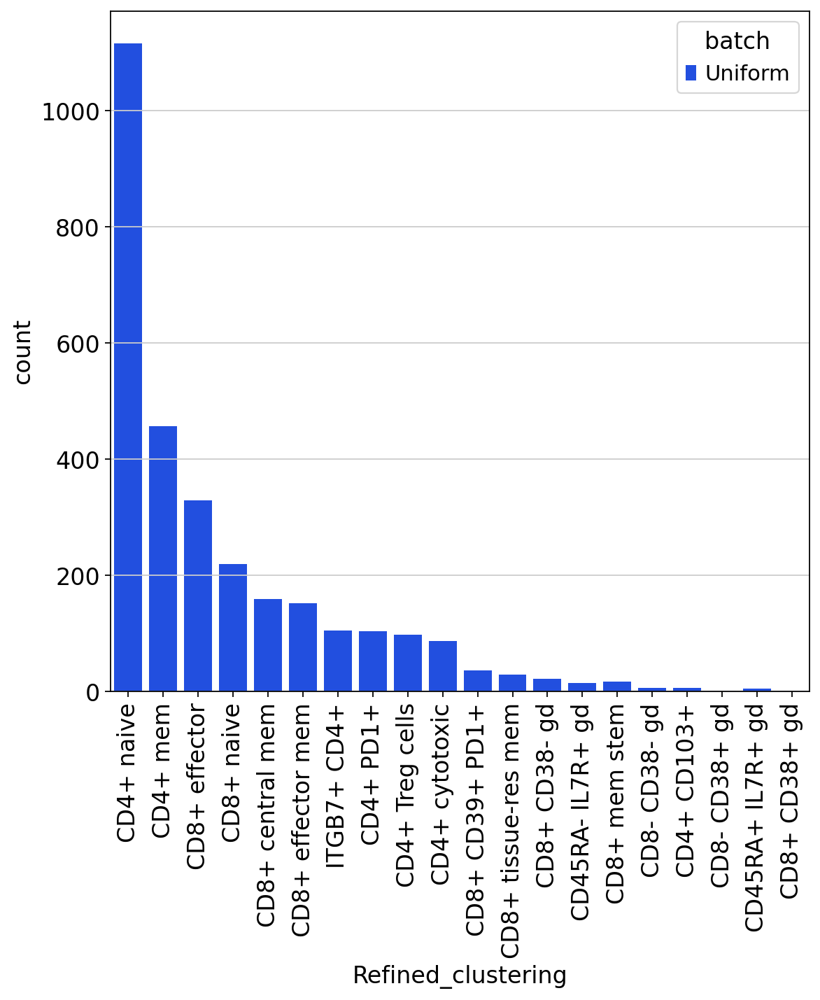

In [31]:
df_mixed = pd.concat([small_random_adata.obs])
g2 = sns.countplot(data=df_mixed, x="Refined_clustering", hue="batch", palette="bright", order=cell_type_order)
plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 [Text(0, 0, 'CD4+ naive'),
  Text(1, 0, 'CD4+ mem'),
  Text(2, 0, 'CD8+ effector'),
  Text(3, 0, 'CD8+ naive'),
  Text(4, 0, 'CD8+ central mem'),
  Text(5, 0, 'CD8+ effector mem'),
  Text(6, 0, 'ITGB7+ CD4+'),
  Text(7, 0, 'CD4+ PD1+'),
  Text(8, 0, 'CD4+ Treg cells'),
  Text(9, 0, 'CD4+ cytotoxic'),
  Text(10, 0, 'CD8+ CD39+ PD1+'),
  Text(11, 0, 'CD8+ tissue-res mem'),
  Text(12, 0, 'CD8+ CD38- gd'),
  Text(13, 0, 'CD45RA- IL7R+ gd'),
  Text(14, 0, 'CD8+ mem stem'),
  Text(15, 0, 'CD8- CD38- gd'),
  Text(16, 0, 'CD4+ CD103+'),
  Text(17, 0, 'CD8- CD38+ gd'),
  Text(18, 0, 'CD45RA+ IL7R+ gd'),
  Text(19, 0, 'CD8+ CD38+ gd')])

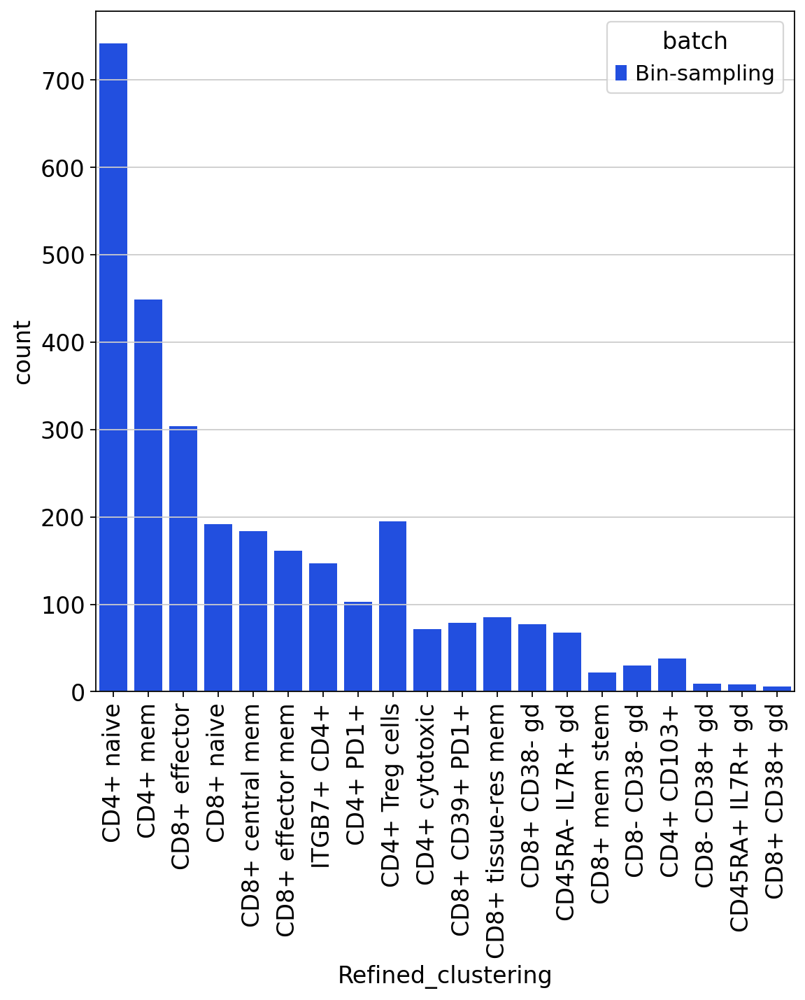

In [32]:
df_mixed = pd.concat([small_partially_adata.obs])
g2 = sns.countplot(data=df_mixed, x="Refined_clustering", hue="batch", palette="bright", order=cell_type_order)
plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 [Text(0, 0, 'CD4+ naive'),
  Text(1, 0, 'CD4+ mem'),
  Text(2, 0, 'CD8+ effector'),
  Text(3, 0, 'CD8+ naive'),
  Text(4, 0, 'CD8+ central mem'),
  Text(5, 0, 'CD8+ effector mem'),
  Text(6, 0, 'ITGB7+ CD4+'),
  Text(7, 0, 'CD4+ PD1+'),
  Text(8, 0, 'CD4+ Treg cells'),
  Text(9, 0, 'CD4+ cytotoxic'),
  Text(10, 0, 'CD8+ CD39+ PD1+'),
  Text(11, 0, 'CD8+ tissue-res mem'),
  Text(12, 0, 'CD8+ CD38- gd'),
  Text(13, 0, 'CD45RA- IL7R+ gd'),
  Text(14, 0, 'CD8+ mem stem'),
  Text(15, 0, 'CD8- CD38- gd'),
  Text(16, 0, 'CD4+ CD103+'),
  Text(17, 0, 'CD8- CD38+ gd'),
  Text(18, 0, 'CD45RA+ IL7R+ gd'),
  Text(19, 0, 'CD8+ CD38+ gd')])

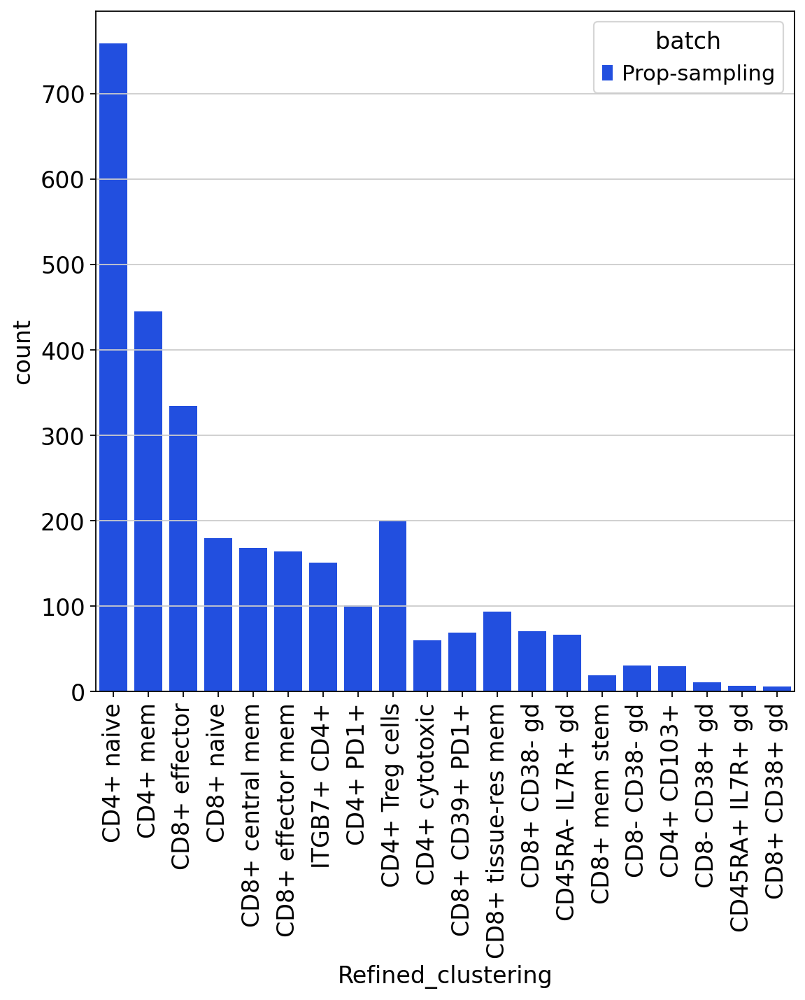

In [33]:
df_mixed = pd.concat([small_prop_adata.obs])
g2 = sns.countplot(data=df_mixed, x="Refined_clustering", hue="batch", palette="bright", order=cell_type_order)
plt.xticks(rotation=90)

In [34]:
df_mixed = pd.concat([small_random_adata.obs, small_partially_adata.obs, small_prop_adata])
g2 = sns.countplot(data=df_mixed, x="Refined_clustering", hue="batch", palette="bright")
plt.xticks(rotation=90)

TypeError: cannot concatenate object of type '<class 'anndata._core.anndata.AnnData'>'; only Series and DataFrame objs are valid

### Bootstraping

In [37]:
def repeat_sampling(ref_adata, rep = 5, seed=12345):
    np.random.seed(seed)
    
    groupped_df = pd.DataFrame(data=None, columns=["count", "Refined_clustering", "batch"])
    for i in range(rep):
        new_seed = np.random.randint(100000)
        
        ps,_ = bin_sample(ref_adata, n_bins=14, s_size=20, seed=new_seed)
        rs = sample_random(ref_adata, s_size=ps.size, seed=new_seed)
        prop_s, _ = proportional_sampling(ref_adata, n_bins=14, total_size=150, power= 0.01, seed= new_seed)
        # bpp_s, tot = bin_sampleـpercentile_power(ref_adata, n_bins=14, total_size=150, power= 1, seed= new_seed)



        a= ref_adata[rs].obs['Refined_clustering'].value_counts().to_list()
        b= list(ref_adata[rs].obs['Refined_clustering'].value_counts().keys())
        c = ["Uniform" for i in a]
        g_df1 = pd.DataFrame({"count": a, "Refined_clustering": b, "batch": c})
        
        a= ref_adata[ps].obs['Refined_clustering'].value_counts().to_list()
        b= list(ref_adata[ps].obs['Refined_clustering'].value_counts().keys())
        c = ["Bin-sampling" for i in a]
        g_df2 = pd.DataFrame({"count": a, "Refined_clustering": b, "batch": c})
        

        a= ref_adata[prop_s].obs['Refined_clustering'].value_counts().to_list()
        b= list(ref_adata[prop_s].obs['Refined_clustering'].value_counts().keys())
        c = ["Proportional_per_bin_counts" for i in a]
        g_df3 = pd.DataFrame({"count": a, "Refined_clustering": b, "batch": c})
        
        # a= ref_adata[bpp_s].obs['Refined_clustering'].value_counts().to_list()
        # b= list(ref_adata[bpp_s].obs['Refined_clustering'].value_counts().keys())
        # c = ["percentile_pow=1" for i in a]
        # g_df4 = pd.DataFrame({"count": a, "Refined_clustering": b, "batch": c})
        
        groupped_df = pd.concat([groupped_df, g_df1, g_df2, g_df3])
    return groupped_df

In [38]:
# ps = bin_sample(ref_adata, n_bins=14, s_size=20)
# print(ps.size)
# rs = sample_random(ref_adata, s_size=ps.size)

In [39]:
df = repeat_sampling(ref_adata, rep=40)
l = df['Refined_clustering'].unique()

In [40]:
df['batch'].unique()

array(['Uniform', 'Bin-sampling', 'Proportional_per_bin_counts'],
      dtype=object)

In [41]:
m1 = df[df['batch'].isin(['Uniform'])]
m2 = df[df['batch'].isin(['Bin-sampling'])]
m3 = df[df['batch'].isin(['Proportional_per_bin_counts'])]

In [42]:
# m1 = df[df['batch'].isin(['Uniform'])]
# m2 = df[df['batch'].isin(['Proportional_per_bin_counts', 'percentile_pow=1'])]

In [43]:
# l = df['Refined_clustering'].unique()
# l1, l2, l3, l4 = np.array_split(l, 4)
# sub_df1 = df[df['Refined_clustering'].isin(l1)]
# sub_df2 = df[df['Refined_clustering'].isin(l2)]
# sub_df3 = df[df['Refined_clustering'].isin(l3)]
# sub_df4 = df[df['Refined_clustering'].isin(l4)]

In [44]:
l = df['Refined_clustering'].unique()
# sub_df1 = df[df['Refined_clustering'].isin(l1)]
# sub_df2 = df[df['Refined_clustering'].isin(l2)]
# sub_df3 = df[df['Refined_clustering'].isin(l3)]
# sub_df4 = df[df['Refined_clustering'].isin(l4)]

In [45]:
ref_adata.obs['Refined_clustering'].value_counts()

CD4+ naive             7338
CD4+ mem               3439
CD8+ effector          2009
CD8+ naive             1401
CD8+ central mem       1039
CD8+ effector mem       978
ITGB7+ CD4+             816
CD4+ PD1+               700
CD4+ Treg cells         667
CD4+ cytotoxic          568
CD8+ CD39+ PD1+         204
CD8+ tissue-res mem     198
CD8+ CD38- gd           189
CD45RA- IL7R+ gd        140
CD8+ mem stem           132
CD8- CD38- gd            66
CD4+ CD103+              65
CD8- CD38+ gd            22
CD45RA+ IL7R+ gd         20
CD8+ CD38+ gd             9
Name: Refined_clustering, dtype: int64

In [46]:
m1['Refined_clustering'].value_counts()

CD4+ naive             40
CD4+ cytotoxic         40
CD4+ CD103+            40
CD8- CD38- gd          40
CD8+ CD39+ PD1+        40
CD45RA- IL7R+ gd       40
CD8+ mem stem          40
CD8+ tissue-res mem    40
CD4+ mem               40
CD8+ CD38- gd          40
CD4+ PD1+              40
CD4+ Treg cells        40
ITGB7+ CD4+            40
CD8+ effector mem      40
CD8+ central mem       40
CD8+ naive             40
CD8+ effector          40
CD8- CD38+ gd          39
CD45RA+ IL7R+ gd       38
CD8+ CD38+ gd          33
Name: Refined_clustering, dtype: int64

In [87]:
m2['Refined_clustering'].value_counts()

CD4+ naive             40
CD4+ mem               40
CD45RA+ IL7R+ gd       40
CD8- CD38+ gd          40
CD8+ mem stem          40
CD8- CD38- gd          40
CD4+ CD103+            40
CD45RA- IL7R+ gd       40
CD4+ cytotoxic         40
CD8+ CD38- gd          40
CD8+ CD39+ PD1+        40
CD8+ tissue-res mem    40
CD4+ PD1+              40
ITGB7+ CD4+            40
CD8+ effector mem      40
CD8+ central mem       40
CD8+ naive             40
CD4+ Treg cells        40
CD8+ effector          40
CD8+ CD38+ gd          40
Name: Refined_clustering, dtype: int64

In [88]:
m3['Refined_clustering'].value_counts()

CD4+ naive             40
CD4+ mem               40
CD8- CD38+ gd          40
CD45RA+ IL7R+ gd       40
CD8+ mem stem          40
CD8- CD38- gd          40
CD4+ CD103+            40
CD45RA- IL7R+ gd       40
CD8+ CD39+ PD1+        40
CD8+ CD38- gd          40
CD8+ tissue-res mem    40
CD4+ cytotoxic         40
CD4+ PD1+              40
ITGB7+ CD4+            40
CD8+ naive             40
CD8+ central mem       40
CD8+ effector mem      40
CD4+ Treg cells        40
CD8+ effector          40
CD8+ CD38+ gd          40
Name: Refined_clustering, dtype: int64

In [47]:
sns.set(font_scale=1.5)


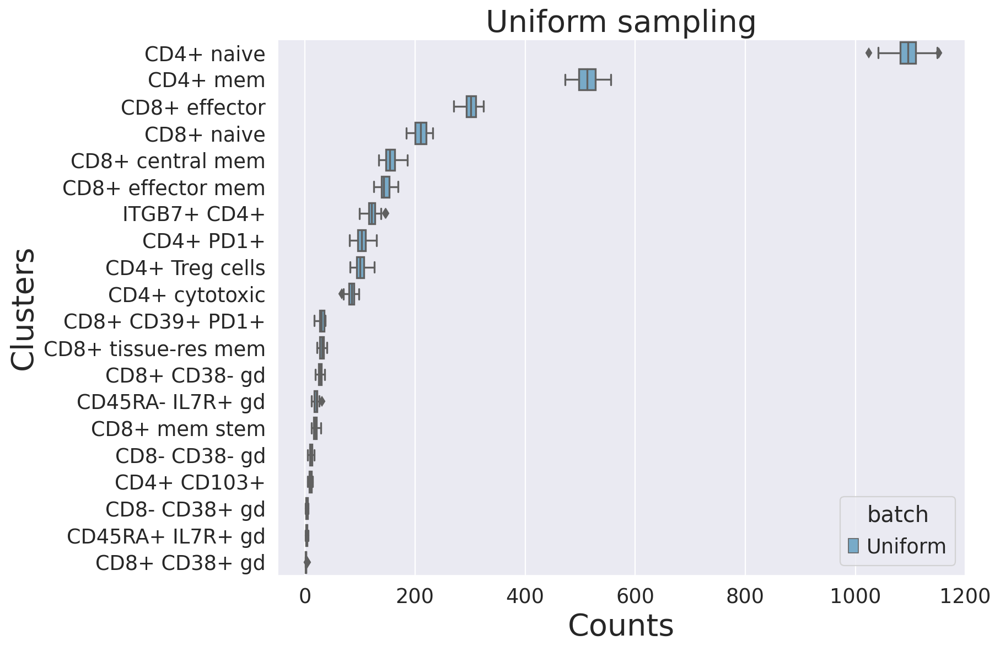

In [48]:
plt.figure(figsize=(10, 8))
g = sns.boxplot(y="Refined_clustering", x="count", hue='batch',data=m1, orient='h', order= cell_type_order, palette="Blues")
plt.xlim(-50, 1200)
# plt.xticks(rotation=90)
plt.ylabel("Clusters", size = 25)
plt.xlabel("Counts", size = 25)
plt.title("Uniform sampling", size= 25)
plt.savefig("Uniform.png", dpi=200, bbox_inches='tight', pad_inches = 0.5)

In [49]:
m2['batch'] = "Fixed_size_bin_sampling"

/tmp/5897272.1.all.q/ipykernel_157775/858523626.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  m2['batch'] = "Fixed_size_bin_sampling"


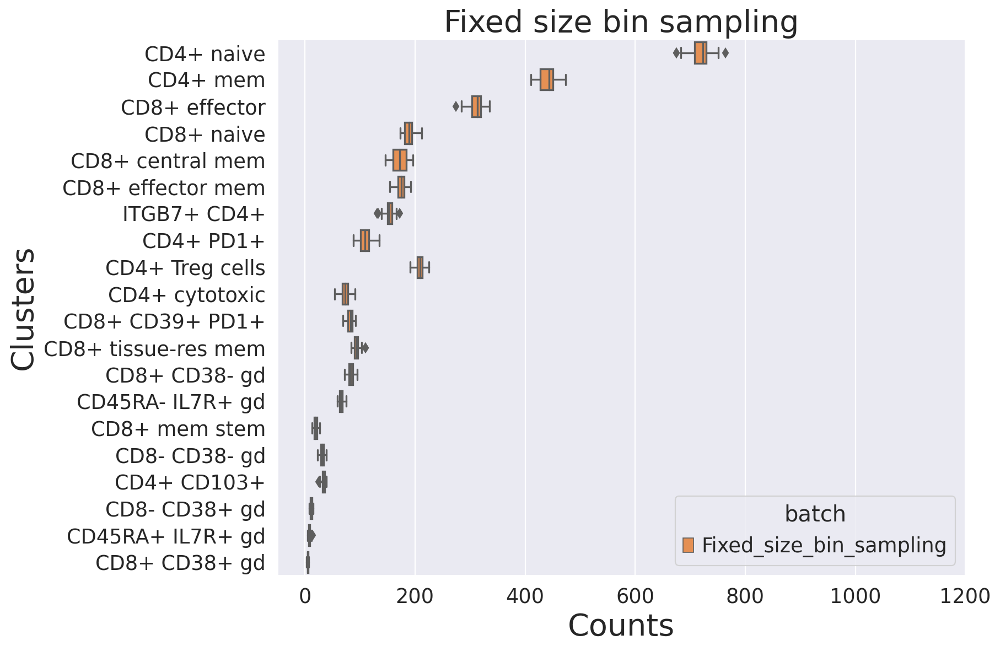

In [50]:
plt.figure(figsize=(10, 8))
g = sns.boxplot(y="Refined_clustering", x="count", hue='batch',data=m2, orient='h', order= cell_type_order, palette='Oranges')
plt.xlim(-50, 1200)
# plt.xticks(rotation=90)
plt.ylabel("Clusters", size = 25)
plt.xlabel("Counts", size = 25)
plt.title("Fixed size bin sampling",  size= 25)
plt.savefig("Fixed_size_bin_sampling.png", dpi=200, bbox_inches='tight', pad_inches = 0.5)

In [51]:
m3['batch'] = "Proportional_per_bin_counts"

/tmp/5897272.1.all.q/ipykernel_157775/3258943198.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  m3['batch'] = "Proportional_per_bin_counts"


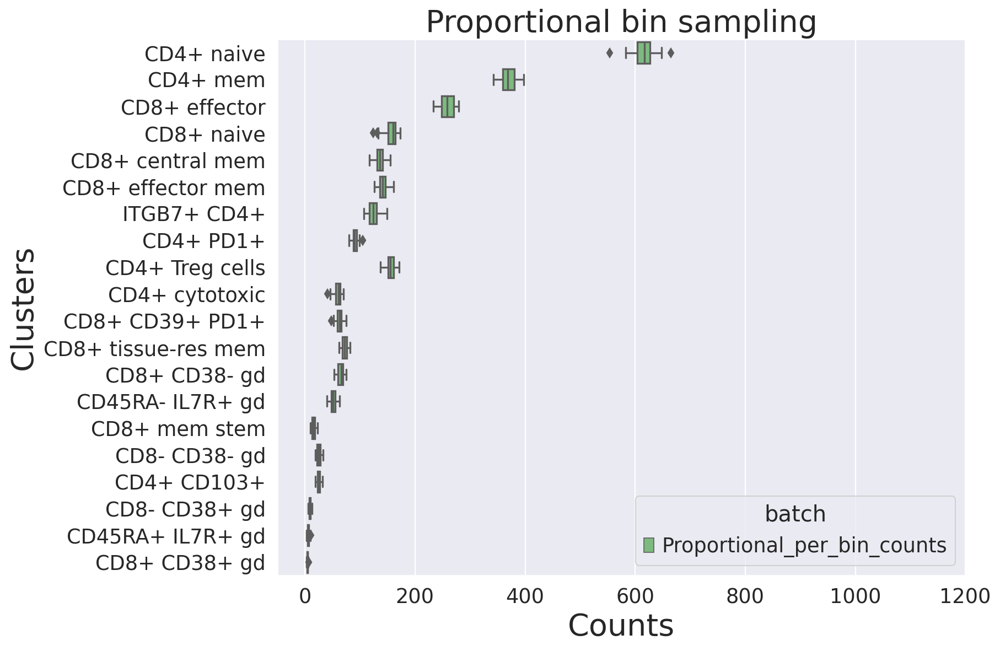

In [52]:
plt.figure(figsize=(10, 8))
g = sns.boxplot(y="Refined_clustering", x="count", hue='batch',data=m3, orient='h', order= cell_type_order, palette="Greens")
plt.xlim(-50, 1200)
# plt.xticks(rotation=90)
plt.ylabel("Clusters", size = 25)
plt.xlabel("Counts", size = 25)
plt.title("Proportional bin sampling",  size= 25)
plt.savefig("Proportional_per_bin_counts.png", dpi=200, bbox_inches='tight', pad_inches = 0.5)

In [43]:
# plt.figure(figsize=(10, 8))
# g = sns.boxplot(x="Refined_clustering", y="count", hue='batch',data=sub_df2, )
# plt.xticks(rotation=90)
# # plt.ylabel("Salary in US Dollars", size=14)
# plt.xlabel("Refined_clustering",size=14)
# plt.title("Subsampling of TCell panel_part2", size=18)
# # plt.savefig("grouped_boxplot_Seaborn_boxplot_Python.png")

In [44]:
# plt.figure(figsize=(10, 8))
# g = sns.boxplot(x="Refined_clustering", y="count", hue='batch',data=sub_df3, )
# plt.xticks(rotation=90)
# # plt.ylabel("Salary in US Dollars", size=14)
# plt.xlabel("Refined_clustering",size=14)
# plt.title("Subsampling of TCell panel_part3", size=18)
# # plt.savefig("grouped_boxplot_Seaborn_boxplot_Python.png")

In [45]:
# plt.figure(figsize=(10, 8))
# g = sns.boxplot(x="Refined_clustering", y="count", hue='batch',data=sub_df4, )
# plt.xticks(rotation=90)
# # plt.ylabel("Salary in US Dollars", size=14)
# plt.xlabel("Refined_clustering",size=14)
# plt.title("Subsampling of TCell panel_part4", size=18)
# # plt.savefig("grouped_boxplot_Seaborn_boxplot_Python.png")

### KNN for label transfer

In [56]:
from sklearn import neighbors

In [70]:
from sklearn.metrics import classification_report

def training(index_subset, ref_adata):
    small_adata = ref_adata[index_subset]
    bad_inds = small_adata.obs.index
    bad_df = ref_adata.obs.index.isin(bad_inds)
    
    X_train = small_adata.X
    y_train = small_adata.obs['Refined_clustering']
    X_test = ref_adata[~bad_df].X
    y_test = ref_adata[~bad_df].obs['Refined_clustering']

    clf = neighbors.KNeighborsClassifier(n_neighbors=5)
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)


    cr = classification_report(y_test, y_pred, output_dict=True)
    df_cr = pd.DataFrame(cr)
    return df_cr

In [71]:
def repeat_knn(ref_adata, rep = 5, seed=12345):
    np.random.seed(seed)
    output_random = []
    output_fsbs = []
    output_pbs = []
    
    groupped_df = pd.DataFrame(data=None, columns=["count", "Refined_clustering", "batch"])
    for i in range(rep):
        new_seed = np.random.randint(10675)
        
        ps,_ = bin_sample(ref_adata, n_bins=14, s_size=20, seed=new_seed)
        rs = sample_random(ref_adata, s_size=ps.size, seed=new_seed)
        prop_s, _ = proportional_sampling(ref_adata, n_bins=14, total_size=150, power= 0.01, seed= new_seed)
        
        output_random.append(training(rs, ref_adata))
        output_fsbs.append(training(ps, ref_adata))
        output_pbs.append(training(prop_s, ref_adata))
    return output_random, output_fsbs, output_pbs

In [72]:
output_random, output_fsbs, output_pbs = repeat_knn(ref_adata)

/home/ekarimi/miniconda3/envs/modi/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ekarimi/miniconda3/envs/modi/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ekarimi/miniconda3/envs/modi/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(resu

In [79]:
acc_rand = []
acc_fsbs = []
acc_pbs = []
for i in range(5):
    acc_rand.append(output_random[i]['accuracy'][0])
    acc_fsbs.append(output_fsbs[i]['accuracy'][0])
    acc_pbs.append(output_pbs[i]['accuracy'][0])

In [92]:
np.mean(acc_rand) - np.max(acc_rand)

-0.00414514801436372

In [94]:
np.mean(acc_fsbs) - np.max(acc_fsbs)

-0.005266782719742569

In [96]:
np.mean(acc_pbs) - np.max(acc_pbs)

-0.003764751896203178

In [100]:
c1_rand = []
c1_fsbs = []
c1_pbs = []
for i in range(5):
    c1_rand.append(output_random[i]['CD8+ tissue-res mem'][2])
    c1_fsbs.append(output_fsbs[i]['CD8+ tissue-res mem'][2])
    c1_pbs.append(output_pbs[i]['CD8+ tissue-res mem'][2])

In [105]:
np.mean(c1_rand) - np.min(c1_rand)

0.052953278437149365

In [108]:
np.mean(c1_fsbs) - np.max(c1_fsbs)

-0.02847052419067797

In [111]:
np.mean(c1_pbs) - np.max(c1_pbs)

-0.022284628316243893

In [122]:
c2_rand = []
c2_fsbs = []
c2_pbs = []
for i in range(5):
    c2_rand.append(output_random[i]['CD4+ CD103+'][2])
    c2_fsbs.append(output_fsbs[i]['CD4+ CD103+'][2])
    c2_pbs.append(output_pbs[i]['CD4+ CD103+'][2])

In [127]:
np.mean(c2_rand) - np.max(c2_rand)

-0.07264880976333743

In [129]:
np.mean(c2_fsbs) - np.max(c2_fsbs)

-0.03806116080715627

In [131]:
np.mean(c2_pbs) - np.max(c2_pbs)

-0.032247436773752525

In [ ]:

small_partially_adata = ref_adata[s_partially_s]
plot_umap(small_partially_adata, dictionary)


In [53]:
bad_inds1 = small_partially_adata.obs.index
bad_inds2 = small_random_adata.obs.index
bad_inds3 = small_prop_adata.obs.index


bad_inds = np.concatenate((bad_inds1, bad_inds2, bad_inds3))

In [54]:
bad_df1 = ref_adata.obs.index.isin(bad_inds1)
bad_df2 = ref_adata.obs.index.isin(bad_inds2)
bad_df3 = ref_adata.obs.index.isin(bad_inds3)

In [65]:
df_cr = training(s_partially_s, ref_adata)

In [69]:
df_cr['accuracy']

precision    0.919666
recall       0.919666
f1-score     0.919666
support      0.919666
Name: accuracy, dtype: float64

In [57]:
X_train1 = small_partially_adata.X
y_train1 = small_partially_adata.obs['Refined_clustering']
X_test1 = ref_adata[~bad_df1].X
y_test1 = ref_adata[~bad_df1].obs['Refined_clustering']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train1, y_train1)
y_pred1 = clf.predict(X_test1)

from sklearn.metrics import classification_report

cr1 = classification_report(y_test1, y_pred1, output_dict=True)
df_cr1 = pd.DataFrame(cr1).transpose()
print(classification_report(y_test1, y_pred1))

                     precision    recall  f1-score   support

        CD4+ CD103+       0.96      0.93      0.94        27
          CD4+ PD1+       0.84      0.57      0.68       597
    CD4+ Treg cells       0.94      0.89      0.92       472
     CD4+ cytotoxic       0.92      0.91      0.91       496
           CD4+ mem       0.89      0.92      0.91      2990
         CD4+ naive       0.96      0.99      0.97      6596
   CD45RA+ IL7R+ gd       0.90      0.75      0.82        12
   CD45RA- IL7R+ gd       0.84      0.89      0.86        72
      CD8+ CD38+ gd       0.33      0.33      0.33         3
      CD8+ CD38- gd       0.85      0.91      0.88       112
    CD8+ CD39+ PD1+       0.82      0.86      0.84       125
   CD8+ central mem       0.85      0.90      0.87       855
      CD8+ effector       0.88      0.98      0.93      1705
  CD8+ effector mem       0.87      0.66      0.75       817
      CD8+ mem stem       0.74      0.48      0.58       110
         CD8+ naive    

In [60]:
df_cr1.sort_values('support').transpose()['accuracy'][0]

0.919666451347701

In [59]:
X_train2 = small_random_adata.X
y_train2 = small_random_adata.obs['Refined_clustering']
X_test2 = ref_adata[~bad_df2].X
y_test2 = ref_adata[~bad_df2].obs['Refined_clustering']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train2, y_train2)
y_pred2 = clf.predict(X_test2)

from sklearn.metrics import classification_report
print(classification_report(y_test2, y_pred2))

                                     precision    recall  f1-score   support

                CD4+ CD103+ T cells       1.00      0.54      0.70        59
                  CD4+ PD1+ T cells       0.76      0.68      0.72       596
                    CD4+ Treg cells       0.95      0.89      0.92       569
             CD4+ cytotoxic T cells       0.96      0.88      0.92       481
                CD4+ memory T cells       0.91      0.90      0.91      2982
                 CD4+ naive T cells       0.96      0.99      0.97      6222
           CD45RA+ IL7R+ gd T cells       0.79      0.73      0.76        15
           CD45RA- IL7R+ gd T cells       0.91      0.86      0.89       125
              CD8+ CD38+ gd T cells       0.67      0.29      0.40         7
              CD8+ CD38- gd T cells       0.84      0.90      0.87       167
            CD8+ CD39+ PD1+ T cells       0.82      0.89      0.86       167
        CD8+ central memory T cells       0.83      0.86      0.85       87

In [60]:
X_train3 = small_prop_adata.X
y_train3 = small_prop_adata.obs['Refined_clustering']
X_test3 = ref_adata[~bad_df3].X
y_test3 = ref_adata[~bad_df3].obs['Refined_clustering']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train3, y_train3)
y_pred3 = clf.predict(X_test3)

from sklearn.metrics import classification_report
print(classification_report(y_test3, y_pred3))

                                     precision    recall  f1-score   support

                CD4+ CD103+ T cells       0.97      0.83      0.89        35
                  CD4+ PD1+ T cells       0.81      0.62      0.70       599
                    CD4+ Treg cells       0.91      0.93      0.92       467
             CD4+ cytotoxic T cells       0.95      0.86      0.90       508
                CD4+ memory T cells       0.91      0.93      0.92      2994
                 CD4+ naive T cells       0.97      0.99      0.98      6579
           CD45RA+ IL7R+ gd T cells       1.00      0.85      0.92        13
           CD45RA- IL7R+ gd T cells       0.89      0.93      0.91        73
              CD8+ CD38+ gd T cells       0.00      0.00      0.00         3
              CD8+ CD38- gd T cells       0.92      0.94      0.93       118
            CD8+ CD39+ PD1+ T cells       0.85      0.86      0.85       135
        CD8+ central memory T cells       0.85      0.90      0.87       87

### Checking the accuracy on the whole data

In [ ]:
bad_df1 = adata.obs.index.isin(bad_inds1)

X_train1 = small_partially_adata.X
y_train1 = small_partially_adata.obs['Refined_clustering']
X_test1 = adata[~bad_df1].X
y_test1 = adata[~bad_df1].obs['Refined_clustering']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train1, y_train1)
y_pred1 = clf.predict(X_test1)

from sklearn.metrics import classification_report
print(classification_report(y_test1, y_pred1))

                                     precision    recall  f1-score   support

                CD4+ CD103+ T cells       0.92      0.95      0.94      3359
                  CD4+ PD1+ T cells       0.85      0.60      0.70     35271
                    CD4+ Treg cells       0.95      0.92      0.93     33098
             CD4+ cytotoxic T cells       0.96      0.90      0.93     30058
                CD4+ memory T cells       0.88      0.95      0.91    177156
                 CD4+ naive T cells       0.97      0.98      0.98    385857
           CD45RA+ IL7R+ gd T cells       0.90      0.45      0.60       738
           CD45RA- IL7R+ gd T cells       0.88      0.90      0.89      7903
              CD8+ CD38+ gd T cells       0.92      0.25      0.39       511
              CD8+ CD38- gd T cells       0.84      0.92      0.88      8876
            CD8+ CD39+ PD1+ T cells       0.80      0.87      0.83     10282
        CD8+ central memory T cells       0.84      0.89      0.86     5709

In [133]:
bad_df2 = adata.obs.index.isin(bad_inds2)

X_train2 = small_random_adata.X
y_train2 = small_random_adata.obs['Refined_clustering']
X_test2 = adata[~bad_df2].X
y_test2 = adata[~bad_df2].obs['Refined_clustering']

clf = neighbors.KNeighborsClassifier(n_neighbors=5)
clf.fit(X_train2, y_train2)
y_pred2 = clf.predict(X_test2)

from sklearn.metrics import classification_report
print(classification_report(y_test2, y_pred2))

/home/ekarimi/miniconda3/envs/modi/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ekarimi/miniconda3/envs/modi/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


                                     precision    recall  f1-score   support

                CD4+ CD103+ T cells       0.94      0.89      0.91      3393
                  CD4+ PD1+ T cells       0.85      0.53      0.65     35281
                    CD4+ Treg cells       0.96      0.89      0.92     33209
             CD4+ cytotoxic T cells       0.94      0.93      0.93     30037
                CD4+ memory T cells       0.88      0.95      0.91    177094
                 CD4+ naive T cells       0.97      0.99      0.98    385464
           CD45RA+ IL7R+ gd T cells       0.00      0.00      0.00       744
           CD45RA- IL7R+ gd T cells       0.87      0.84      0.86      7950
              CD8+ CD38+ gd T cells       0.00      0.00      0.00       514
              CD8+ CD38- gd T cells       0.78      0.91      0.84      8934
            CD8+ CD39+ PD1+ T cells       0.78      0.88      0.83     10319
        CD8+ central memory T cells       0.85      0.89      0.87     5710

/home/ekarimi/miniconda3/envs/modi/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
